# Gruppo M (Mohamed Boutaleb, Francesco Moro)

# Progetto Data Science - Analisi di Craigslist

## Introduzione
In questo notebook verrà effettuata l'analisi del [dataset di craigslist](https://www.kaggle.com/austinreese/craigslist-carstrucks-data), un noto portale americano che ospita annunci dedicati al lavoro, eventi, acquisti, incontri e altri servizi.

Il dataset è stato creato tramite [web scraping](https://github.com/AustinReese/UsedVehicleSearch) dall'autore stesso.

In [1]:
### Keeping safe from any disaster :) ###
%autosave 30

Autosaving every 30 seconds


### Librerie utilizzate
Per queste analisi abbiamo utilizzato alcune librerie trattate durante il corso ed in parte altre basandoci sulla loro documentazione. Di seguito l'elenco:
* numpy
* pandas
* plotly

* seaborn
* matplotlib

In [2]:
### Imports ###
import numpy as np
import pandas as pd

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly

import seaborn as sns
import matplotlib.pyplot as plt

## Lettura del dataset
Al fine di poter importare correttamente il dataset è necessario:
* Scaricare lo zip da [qui](https://www.kaggle.com/austinreese/craigslist-carstrucks-data)
* Estrarlo
* Spostarlo all'interno della directory `/resources/dataset/`

In [3]:
### Reading .csv dataset ###
df = pd.read_csv("resources/dataset/vehicles.csv")

## Analisi preliminari
### Quali sono le colonne?

In [4]:
df.head(1)

,id,url,region,region_url,price,year,manufacturer,model,condition,cylinders,...,drive,size,type,paint_color,image_url,description,county,state,lat,long
0,7184791621,https://duluth.craigslist.org/ctd/d/duluth-200...,duluth / superior,https://duluth.craigslist.org,6995,2000.0,gmc,new sierra 1500,excellent,8 cylinders,...,4wd,NaN,NaN,red,https://images.craigslist.org/00n0n_f06ykBMcdh...,2000 *** GMC New Sierra 1500 Ext Cab 157.5 WB...,NaN,mn,46.8433,-92.255


In [5]:
df.columns

Index(['id', 'url', 'region', 'region_url', 'price', 'year', 'manufacturer',
       'model', 'condition', 'cylinders', 'fuel', 'odometer', 'title_status',
       'transmission', 'vin', 'drive', 'size', 'type', 'paint_color',
       'image_url', 'description', 'county', 'state', 'lat', 'long'],
      dtype='object')

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 423857 entries, 0 to 423856
Data columns (total 25 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            423857 non-null  int64  
 1   url           423857 non-null  object 
 2   region        423857 non-null  object 
 3   region_url    423857 non-null  object 
 4   price         423857 non-null  int64  
 5   year          328743 non-null  float64
 6   manufacturer  313242 non-null  object 
 7   model         325384 non-null  object 
 8   condition     176719 non-null  object 
 9   cylinders     197679 non-null  object 
 10  fuel          327214 non-null  object 
 11  odometer      270585 non-null  float64
 12  title_status  327759 non-null  object 
 13  transmission  328065 non-null  object 
 14  vin           184420 non-null  object 
 15  drive         231119 non-null  object 
 16  size          102627 non-null  object 
 17  type          241157 non-null  object 
 18  pain

### Una visione un po' più concreta
Tentando di lanciare la seguente cella notiamo subito come il tempo di computazione sia molto alto.

In [7]:
# plt.figure(figsize=(27,12))
# plt.title("Missing values for each column")
# dfT=df.isnull().transpose()
# fig=sns.heatmap(dfT)

# plt.savefig('density.png', dpi=300)

### Un primo approccio
Il dataset considerato necessita tempi computazionali piuttosto onerosi per certe operazioni, quindi, abbiamo provato ad aggirare il problema considerando inizialmente solamente le osservazioni registrate tra il 2016 e il 2019.

Questo non è stato un approccio molto efficiente: da una parte i tempi di calcolo erano stati ridotti, ma dall'altro lato abbiamo perso dati importanti, riducendo il valore della raccolta.

In [8]:
### No more used ###

### Filtering more recent occurrences ###
# mask=(df["year"]>2015.0) & (df["year"]<2020)

### Applying the mask ###
# dfByYear=df[mask]

### Convert dataframe object to .csv file ###
# dfByYear.to_csv("resources/dataset/filteredByYear.csv", index=False)

### Reading from filesystem .csv dataset ###
#dfByYear = pd.read_csv("resources/dataset/filteredByYear.csv")

### Sampling
Abbiamo deciso quindi di considerare 80'000 campioni per i calcoli più lunghi.

In [9]:
### Dataframe sampling ###
dfs=df.sample(n=80000)

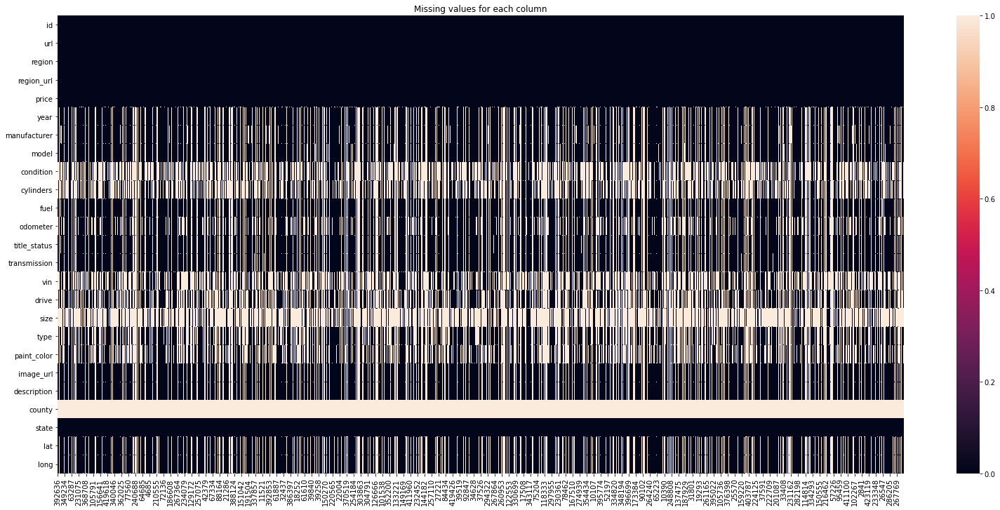

In [10]:
plt.figure(figsize=(27,12))
plt.title("Missing values for each column")
dfT=dfs.isnull().transpose()
fig=sns.heatmap(dfT)

plt.savefig('density.png', dpi=300)

In [11]:
### Dropping for semplicity useless columns ###
df = df.drop(columns=["url","region_url","image_url","county"])

## Quali sono i marchi più venduti?
La prima domanda ovvia che ci siamo posti è qual è il marchio più venduto su Craiglist.

Ci aspettavamo come risposta nè un marchio di lusso nè tanto meno uno di bassa qualità, altrimenti nessuno lo comprerebbe.

In [12]:
### Create a new grouped by manufacturer dataframe object###
occurrenciesByManufacturer = dfs.groupby(["manufacturer"]).size().reset_index(name="counts")

### Getting relative frequencies ###
occurrenciesByManufacturer["relative_freq"] = occurrenciesByManufacturer["counts"] /\
    occurrenciesByManufacturer["counts"].sum()

### Sorting dataframe by number of occurrences for each manufacturer ###   
occurrenciesByManufacturer = occurrenciesByManufacturer.sort_values(
    "counts", ascending=True)

### Giving our char a name ###
title = "Number of traded cars for each manufacturer"

### Creating the bar chart ###
fig = px.bar(occurrenciesByManufacturer, y="manufacturer",
             x="counts", text="counts", title=title, height=1000)

### Formatting values labels ###
fig.update_traces(texttemplate="%{text:.2s}", textposition="outside")

### Show ###
fig.show()

# save as html
#plotly.offline.plot(fig, filename=f"{figTitle}.html")

### Perché proprio Ford? 
Le cause sono principalmente le seguenti:
* Fondata negli USA nel 1903
* Rivoluzione industriale -> con l'avvento della catena di montaggio nacque una produzione di massa anche di Ford
* Nazionalismo americano
* Famosa per veicoli piuttosto grandi, amati dagli americani

### Qual è il modello più venduto?
La risposta, a nostro parere non così prevedibile, è il <b>pickup</b>.
<br>
<br>
Infatti, questa tipologia di veicolo viene molto acquistata e venduta nel territorio americano. Anche nei film viene vista come la tipica macchina usata dal buon padre di famiglia.
<br>
<br>
Alcune tra le motivazioni più rilevanti: 
* Potenza sufficiente per trainare o trasportare praticamente qualsiasi cosa
* Più che sufficiente spazio interno
* Discreto numero di cavalli per trasportare carichi importanti
* Notevole risparmio di carburante
* Studi che dimostrano che i pickup sono più sicuri rispetto ad altre macchine: assicurazioni meno costose!

In [13]:
### Considering only for vehicles ###
result=df.loc[df["manufacturer"]=="ford", 'model']

### Create a new dataframe instance based on the previous mask ###
resultDf=pd.DataFrame(result)

### Creating the histogram ###
px.histogram(resultDf, barmode="overlay", y="model", height=1000)

### Taking some model labels and values 
modelLabels = df[df["manufacturer"]=="ford"].model.value_counts().head(10).index
modelValues = df[df["manufacturer"]=="ford"].model.value_counts().head(10).values

### Making place for other traces ###
fig = make_subplots(rows=1, cols=1, specs=[[{"type":"domain"}]])

### Adding the new trace###
fig.add_trace(go.Pie(labels=modelLabels, values=modelValues, title="Ford models"),
              1, 1)

### Show ###
fig.show()

### Optionally save it as .html/.png file ###
#plotly.offline.plot(fig, filename=f"{title}.html")
#fig.write_image(f"{title}.png")

### Dove sono usati i pickup?
Inizialmente, pensavamo che pickup fossero presenti maggiormente nelle zone aride/fuoristrada e meno nelle aree urbane.

Tuttavia, dal seguente grafico si evince, al contrario, come la distribuzione dei pickup sia densa specialmente nelle grandi città.

In [14]:
### Cleaning from non-specified values ###
df=df.dropna(subset=["manufacturer"])

### Creating first trace ###
fig=px.scatter_mapbox(df[df["type"]=="pickup"], 
                             lat="lat", lon="long", hover_name="manufacturer", 
                        hover_data=["odometer", "price", "state"], color_discrete_sequence=["blue"], 
                             zoom=4, height=600)

### Customizing map ###
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

### Show ###
fig.show()

### Optionally save it as .html/.png file ###
#title="Geographical position of pickups"
#plotly.offline.plot(fig, filename=f"{title}.html")
#fig.write_image(f"{title}.png")

### Confronto pickup-berline
Pur confrontando la posizione di tutti i pickup con quella delle berline, quindi veicoli che tendenzialmente vengono utilizzati in aree urbane, non abbiamo riscontrato che esista un possibile schema logico che andasse incontro alle nostre aspettative. 

In [15]:
### Cleaning from non-specified values ###
df=df.dropna(subset=["manufacturer"])

### Creating first trace ###
fig=px.scatter_mapbox(df[df["type"]=="hatchback"], 
                             lat="lat", lon="long", hover_name="manufacturer", 
                        hover_data=["odometer", "price", "state"], color_discrete_sequence=["red"], 
                             zoom=4, height=600)

### Customizing map ###
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

### Show ###
fig.show()

### Optionally save it as .html/.png file ###
#title="Geographical position of hatchbacks"
#plotly.offline.plot(fig, filename=f"{title}.html")
#fig.write_image(f"{title}.png")

## Dopo quanti anni un veicolo viene rivenduto?
Fino ai 3 anni di età si ha una crescita ben evidente.
Notiamo un picco massimo dopo 3 anni, e a partire dal quinto anno in poi il numero di macchine vendute tende a diminuire.
<br>
<br>
Arrivando a 12 anni si ha un punto di massimo locale, dovuto probabilmente alla crisi economica del 2008.
La gente necessitava di liquidità, quindi potrebbe aver iniziato a vendere più macchine rispetto a prima.

In [16]:
### Cleaning dataframe from null-year fields ###
df = df[df.year.notnull()]

### Computing ages for each vehicles ###
### For simplicity we will consider 2020 ###
df["age"] = df.year.apply(lambda x: int(2020-x))

### Considering only vehicles with age [0,30] ###
df = df[(df.age >= 0) & (df.age <= 30)]

In [17]:
### Creating a new instance grouping the datagrame by age ###
groupedByAge = df.groupby(["age"]).size().reset_index(name="counts").set_index("age")

### Chart title ###
title="Number of vehicles for each age"

### Creating the line chart ###
fig = px.line(groupedByAge, y="counts", title=title)

### Updating yaxes label ###
fig.update_yaxes(title_text="number of vehicles")

### Show ###
fig.show()

### Optionally save it as .html/.png file ###
#plotly.offline.plot(fig, filename=f"{title}.html")
#fig.write_image(f"{title}.png")

## Con l’avanzare del tempo quale carburante si predilige?
Si può evincere una schiacciante vittoria dei veicoli a benzina.
<br>
Dai dati raccolti da Craigslist non si nota una gran crescita dell’elettrico come dalle nostre aspettative.
<br>
Probabilmente non ne vengono ancora venduti abbastanza su Craigslist per poter fare un confronto con le alternative.

In [18]:
### Cleaning from non-specified values ###
df=df.dropna(subset=["year"])
df=df.dropna(subset=["fuel"])

### Chart title ###
title="Number of cars by fuel"

### Creating the histogram ###
fig=px.histogram(df, x="year", facet_col="fuel", width=800, title=title, facet_col_wrap=2)

### Customizing order shown ###
# fig.update_yaxes(title_text="number of vehicles")

### Show ###
fig.show()

### Optionally save it as .html/.png file ###
#plotly.offline.plot(fig, filename=f"{title}.html")
#fig.write_image(f"{title}.png")

## Come variano i prezzi in base all'alimentazione col tempo?
Dal grafico, si può intuire come con l'avanzare del tempo, il prezzo, in generale, tende a salire, ciò dovuto sicuramente all'evoluzione tecnologica. 

Per quanto riguarda il diesel, la mediana dei prezzi supera i 20k dal 2011, continuando a crescere costantemente con l'avanzare degli anni.
<br>
L'elettrico invece viene introdotto per la prima volta nell'usato dal 2014 su craiglist. Negli ultmi anni come si può evincere questo sta facendo irruzione nel mercato automobilistico. Quindi sul prezzo non è ancora possibile estrapolare delle analisi significative e concrete. 
<br>
La mediana del benzina, in genere, tende ad aumentare leggermente senza brusche fluttuazioni di prezzo. 

In [20]:


title="Boxplot price by fuel"

df["price"]=df["price"].dropna()
df=df.sort_values(by=["year"])
fig=px.box(df,y="fuel",orientation="h", x="price", animation_frame="year", range_x=[0, 100000])

fig.update_layout(title=title)

### Qual è la media di km percorsi per ogni marca al variare degli anni?
E' intuitivo vedere come, la media dei km percorsi aumenta in maniera proporzionale all'aumentare dell'età. 

In [21]:
title="Average of odometer by car manufacturer"

fig=px.histogram(df,orientation="h",animation_frame="year",  y="manufacturer", 
                 x="odometer", histfunc="avg", height=1000)
fig.update_yaxes(categoryorder="total ascending")
fig.update_layout(title=title)

### Come è distribuito il colore in base al tipo di veicolo?
I SUV sono la tipologia di veicolo più frequente nel sito di craiglist. 
In generale si può evincere che il nero tende ed essere più frequente nella maggior parte dei veicoli.
Si può subito osservare che i colori più frequenti per i SUV e le sedan sono: 
* nero 
* argento
* bianco
* grigio
* blu
* rosso 
<br>
 

In [22]:
x = df.type
y = df.paint_color

fig = go.Figure(go.Histogram2d(
        x=x,
        y=y
    ))

title = "Colors of vehicles by type"
xaxis_title= "Type of vehicle"
yaxis_title= "Color"

fig.update_layout(
title=title,
    xaxis_title=xaxis_title,
    yaxis_title=yaxis_title)


fig.show()

### Le condizione tendono a variare in base alla tipologia di alimentazione?


In [23]:
df=df.dropna(subset=["condition"])

gasLabels = df[df["fuel"]=="gas"].condition.value_counts().head(10).index
gasValues = df[df["fuel"]=="gas"].condition.value_counts().head(10).values

dieselLabels = df[df["fuel"]=="diesel"].condition.value_counts().head(10).index
dieselValues = df[df["fuel"]=="diesel"].condition.value_counts().head(10).values

electricLabels = df[df["fuel"]=="electric"].condition.value_counts().head(10).index
electricValues = df[df["fuel"]=="electric"].condition.value_counts().head(10).values

hybridLabels = df[df["fuel"]=="hybrid"].condition.value_counts().head(10).index
hybridValues = df[df["fuel"]=="hybrid"].condition.value_counts().head(10).values

# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=2, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}], [{'type':'domain'}, {'type':'domain'}]])

fig.add_trace(go.Pie(labels=gasLabels, values=gasValues, name="Gas Car", title="Gas Cars"), 1, 1)
fig.add_trace(go.Pie(labels=dieselLabels, values=dieselValues, name="Diesel Car",title="Diesel Cars"), 1, 2)
fig.add_trace(go.Pie(labels=electricLabels, values=electricValues, name="Electric Car",title="Electric Cars"), 2, 1)
fig.add_trace(go.Pie(labels=hybridLabels, values=hybridValues, name="Hybrid Car",title="Hybrid Cars"), 2, 2)



# Use hole to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent+name")

fig.show()


### Come varia negli anni il prezzo dei veicoli in base alla tipologia?

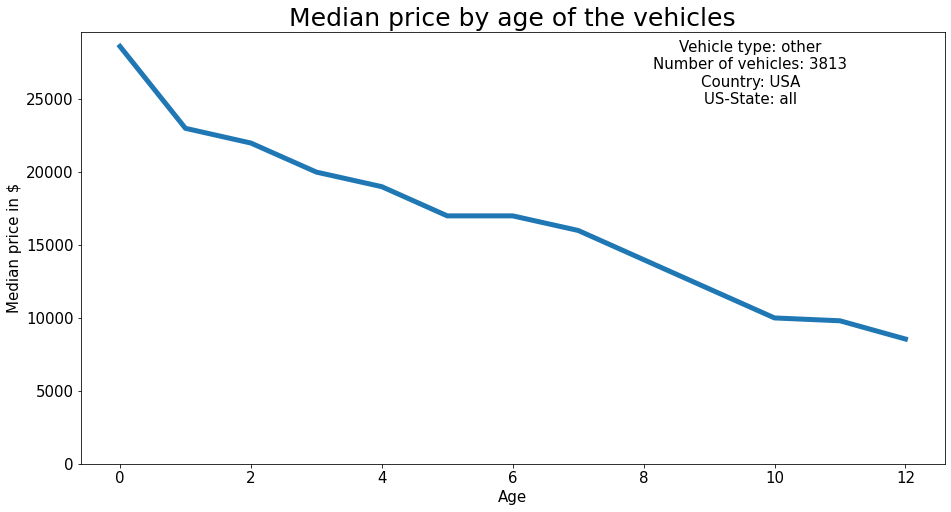

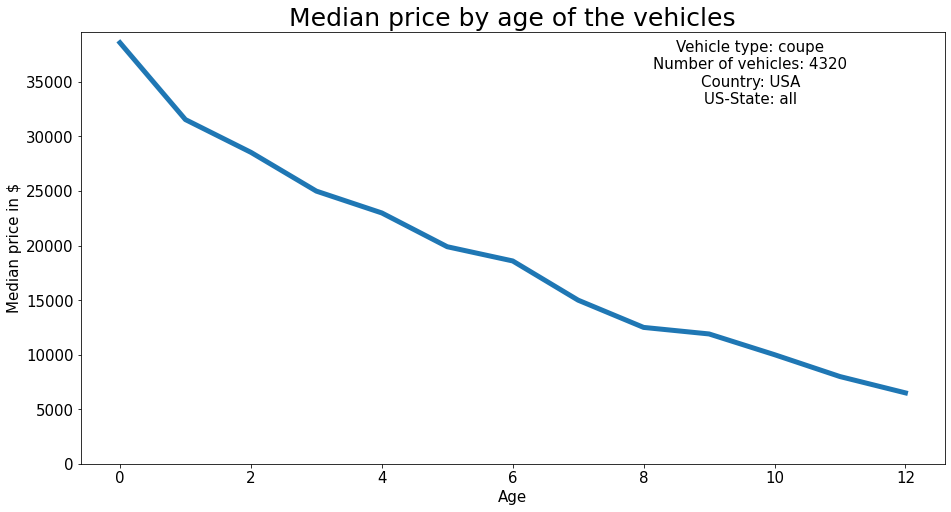

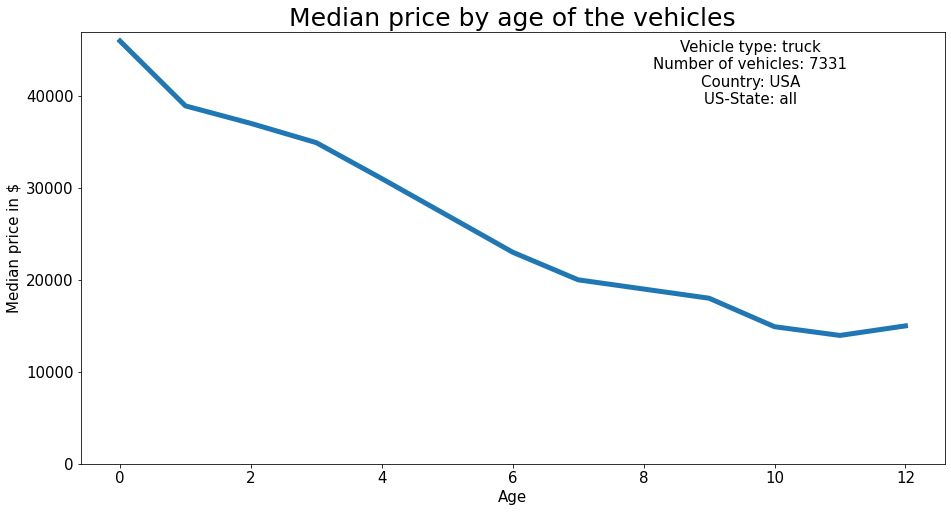

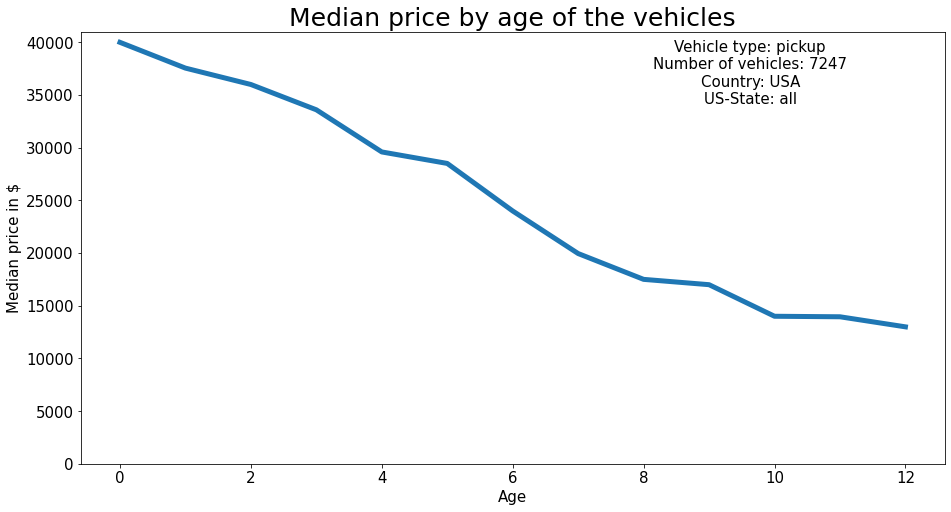

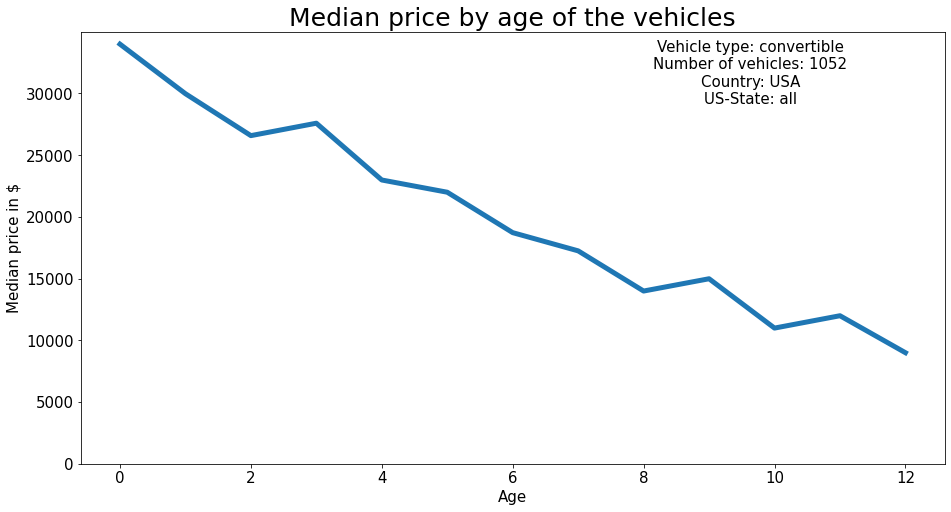

In [24]:
def display_price(df, age = (0,12), price = (100,100000), vehicle_type = "all", state = "all"):
    # Display the median price of vehicles depending on its type and its state.

    if state != "all":
        df = df[df["state"] == state]

    if vehicle_type != "all":
        df = df[df["type"] == vehicle_type]

    df = df[(df["age"] <= age[1]) & (df["age"] >= age[0])]

    df = df[(df["price"] >= price[0]) & (df["price"] <= price[1])]

    price_age = pd.pivot_table(df, values = "price", index = "age", aggfunc= np.median)
    price_age.columns = ["Median Price"]

    fig = plt.figure(figsize=(12,6))
    ax = fig.add_axes([0,0,1,1])
    ax2 = fig.add_axes([0.6,0.47,.35,.35])

    ax.plot(price_age["Median Price"], lw = 5)

    ax2.set_title(f"Vehicle type: {vehicle_type}\nNumber of vehicles: {df.shape[0]}\nCountry: USA\nUS-State: {state}", fontsize = 15)
    ax2.axis('off')

    ax.set_title(f"Median price by age of the vehicles",fontsize=25)
    ax.set_ylim(0,price_age["Median Price"].max()+1000)
    ax.set_xlabel("Age", fontsize = 15)
    ax.set_ylabel("Median price in $", fontsize = 15)

    ax.tick_params(axis='both', which='major', labelsize=15) 

    plt.show()
    
    
df = df.dropna(subset=["type"])
    
df = df[df.year.notnull()]
df["age"] = df.year.apply(lambda x: int(2020-x))
df = df[(df.age >= 0) & (df.age <= 30)]
    

for t in df.type.unique()[:5]:
    display_price(df, vehicle_type=t)